In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
#from shapely.geometry import Point
#from shapely.geometry.polygon import Polygon
import time
import os
import csv
import xlsxwriter

In [2]:
####     READING PERFECT PHOTO     #######
perfect = cv2.imread('pictures_cv/ideal.jpg', cv2.IMREAD_GRAYSCALE)# ENTER YOUR PATH TO PERFECT HERE

In [3]:
######     READING FROM DIRECTORY IN GRAY COLOR     ########

def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder,filename), cv2.IMREAD_GRAYSCALE)
        if img is not None:
            images.append(img)
    return images

In [4]:
folder = 'pictures_cv/'#ENTER YOUR DIRECTORY HERE
images = load_images_from_folder(folder)####IMAGES IS A LIST WITH ALL PICTURES


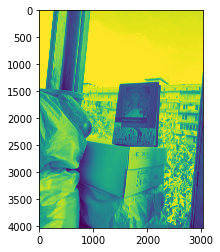

(<matplotlib.image.AxesImage at 0x7fba80ed8550>, None)

In [5]:
plt.imshow(images[2]), plt.show() #### TEST IF ALL RIGHT, YOU SHOULD SEE PICTURE NORMALY

In [6]:
def get_good_matches(matches, len_param):
    good_matches = []
    for m, n in matches:
        if m.distance < len_param*n.distance:
            good_matches.append(m)
    return good_matches

In [7]:
######     SIFT FUNCTION     ############
def sift_cmp(sift, kp_sift_perfect, des_sift_perfect, perfect, not_perfect):
    start = time.time()
    kp_sift_notperfect, des_sift_notperfect = sift.detectAndCompute(not_perfect, None)
    
    #bf = cv2.BFMatcher()
    #matches = bf.knnMatch(des_sift_perfect, des_sift_notperfect, 2)
    matcher = cv2.DescriptorMatcher_create(cv2.DescriptorMatcher_FLANNBASED)
    matches = matcher.knnMatch(des_sift_perfect, des_sift_notperfect, 2)
    
    good_matches = get_good_matches(matches, len_param=0.75)
    
    img_matches = np.empty((max(perfect.shape[0], not_perfect.shape[0]), perfect.shape[1]+not_perfect.shape[1], 3), dtype=np.uint8)
    
    
    cv2.drawMatches(perfect, kp_sift_perfect, not_perfect, kp_sift_notperfect, good_matches, img_matches, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    correct_hit_percent = len(good_matches)/len(kp_sift_notperfect)
    
    end = time.time()
    duration = end - start
    
    #obj = np.empty((len(good_matches),2), dtype=np.float32)
    localization_error = 0
    for i in range(len(good_matches)):
        localization_error = localization_error + good_matches[i].distance/len(good_matches)        
    return img_matches, duration, correct_hit_percent, localization_error ##size_of_photo_in_mb


In [9]:
sift = cv2.SIFT_create() ###### CREATE SIFT, KEYPOINTS AND DESCRIPTORS FROM PERFECT PHOTO
kp_sift_perfect, des_sift_perfect = sift.detectAndCompute(perfect, None)
#

In [10]:
######       CELL FOR RESULT OF SIFT, TIME OF PROCEEDING ~15-20 MINUTES   #######
results_sift = []####ARRAY FOR PICTURES
duration_sift = []####### ARRAY FOR TIME
correct_hit_percents_sift = []#### ARRAY FOR 1ST METRIC
localization_errors_sift = []##### ARRAY FOR 2ND METRIC
size_sift = []#### ARRAY FOR SIZE OF PICTURE IN PIXELS(I GUESS)
for image in images:
    result, duration, correct_hit_percent, l_e = sift_cmp(sift, kp_sift_perfect, des_sift_perfect, perfect, image)#, to_draw_points=False)
    results_sift.append(result)
    duration_sift.append(duration)
    correct_hit_percents_sift.append(correct_hit_percent)
    localization_errors_sift.append(l_e)
    size_sift.append((image.shape[1], image.shape[0]))
    

In [11]:
#### LOOK THROUGH RESULTS TO SEE IF IT ALL RIGHT #######
print(duration_sift, correct_hit_percents_sift, localization_errors_sift, size_sift)

# открываем новый файл на запись
workbook = xlsxwriter.Workbook('sift.xlsx')
# создаем там "лист"
worksheet = workbook.add_worksheet()
# в ячейку A1 пишем текст
worksheet.write('A1', 'localization_error')
worksheet.write('B1', 'correct_hit_percents')
worksheet.write('C1', 'duration')
worksheet.write('D1', 'size')
for i in range(len(localization_errors_sift)): ######### CHANGE ARRAY NAME LOCALIZATION_ERRORS_BRIEF -> YOUR ARRAY
        worksheet.write('A'+str(i+2), str(localization_errors_sift[i]))
        worksheet.write('B'+str(i+2), str(correct_hit_percents_sift[i]))
        worksheet.write('C'+str(i+2), str(duration_sift[i]))
        worksheet.write('D'+str(i+2), str(size_sift[i]))
# сохраняем и закрываем
workbook.close()

###### SAVE ALL ROWS LOKE THIS
with open('local_error_sift.csv', 'w') as f: ##### CHANGE FILENAME
    writer = csv.writer(f)

[2.940016031265259, 3.962510824203491, 2.5951602458953857, 2.450282096862793, 3.142267942428589, 3.0755081176757812, 3.257995843887329, 2.7304131984710693, 2.6421420574188232, 2.882550001144409, 3.0832200050354004, 3.6648669242858887, 2.757612943649292, 3.4692389965057373, 2.6538820266723633, 2.5872421264648438, 3.14060378074646, 3.2500081062316895, 3.155057191848755, 2.870303153991699, 3.4761409759521484, 2.690831184387207, 3.4022459983825684, 3.797869920730591, 3.2557029724121094, 3.4094109535217285, 3.745893955230713, 3.1506948471069336, 2.9804270267486572, 3.0062999725341797, 4.140315055847168, 4.086644887924194, 3.66949200630188, 3.2588558197021484, 4.30995512008667, 3.1835849285125732, 3.0275328159332275, 3.4244327545166016, 3.159794330596924, 3.61783766746521, 2.8459489345550537, 3.4578537940979004, 3.258657217025757, 2.90704083442688, 3.108429193496704, 3.1540873050689697, 3.041766881942749, 3.76202392578125, 3.9430181980133057, 4.727540969848633, 3.9407191276550293, 3.16745090

In [12]:
#### GETTING EXAMPLES  FOR SIFT###########
examples_result_sift = []
for i in range(9):
    result, duration, correct_hit_percent, localization_error = sift_cmp(sift, kp_sift_perfect, des_sift_perfect, perfect, images[10*i + 3])
    examples_result_sift.append(result)

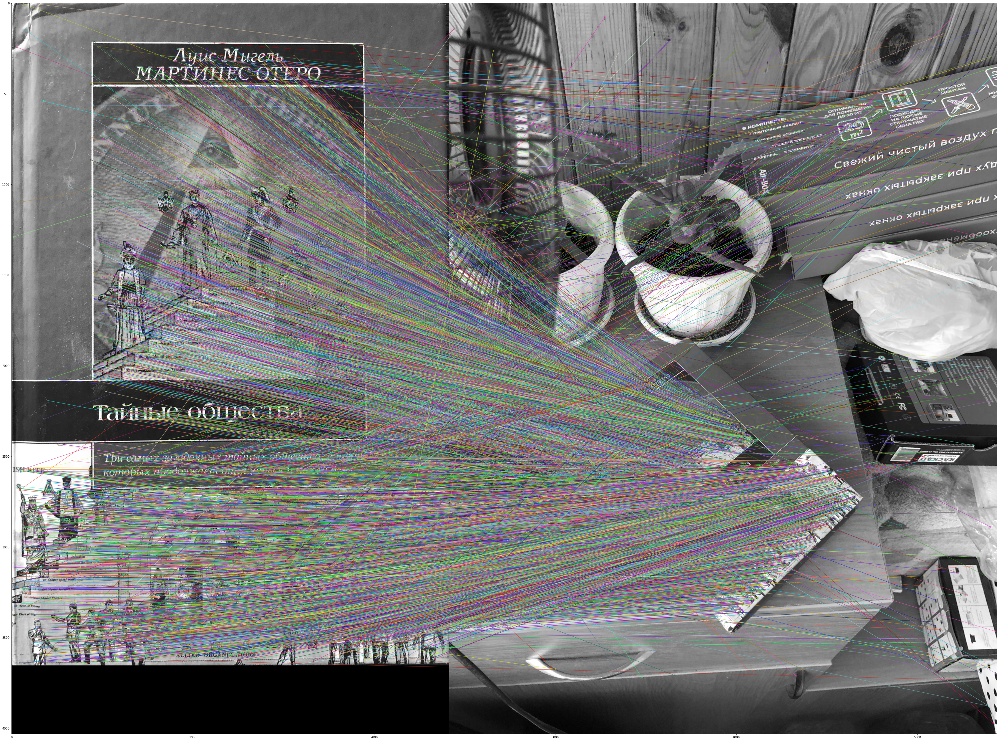

In [13]:
###### DRAWING EXAMPLES #########
fig1, ax1 = plt.subplots(figsize=(60,60))
ax1.imshow(examples_result_sift[1]) #### CHANGE INDEX 0-9 TO GET OTHER EXAMPLES

In [7]:
######     ORB FUNCTION     ############
def orb_cmp(orb, kp_orb_perfect, des_orb_perfect, perfect, not_perfect, to_draw_points):
    start = time.time()
    kp_orb_notperfect, des_orb_notperfect = orb.detectAndCompute(not_perfect, None)
    
    
    keypoints_without_size = np.copy(perfect)
    keypoints_with_size = np.copy(perfect)

    cv2.drawKeypoints(perfect, kp_orb_perfect, keypoints_without_size, color = (0, 255, 0))

    cv2.drawKeypoints(perfect, kp_orb_perfect, keypoints_with_size, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)
    matches = bf.match(des_orb_notperfect, des_orb_perfect)
    
    good_matches = matches
    img_matches = np.empty((max(perfect.shape[0], not_perfect.shape[0]), perfect.shape[1]+not_perfect.shape[1], 3), dtype=np.uint8)
    
    if to_draw_points:
        cv2.drawMatches(perfect, kp_orb_perfect, not_perfect, kp_orb_notperfect, good_matches, img_matches, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    correct_hit_percent = len(good_matches)/len(kp_orb_notperfect)
    
    end = time.time()
    duration = end - start
    
    localization_error = 0
    for i in range(len(good_matches)):
        localization_error = localization_error + good_matches[i].distance/len(good_matches)      
    return img_matches, duration, correct_hit_percent, localization_error


In [8]:
orb = cv2.ORB_create()
kp_orb_perfect, des_orb_perfect = orb.detectAndCompute(perfect, None)


In [9]:
a, b, c, d = orb_cmp(orb, kp_orb_perfect, des_orb_perfect, perfect, images[2], True)### TEST FOR ORB, SHOULD WORK

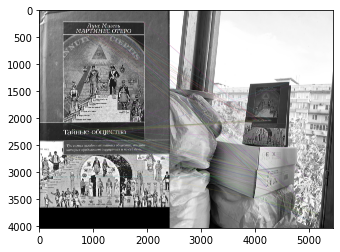

(<matplotlib.image.AxesImage at 0x7fba80f3f730>, None)

In [10]:
plt.imshow(a), plt.show() #### TEST IF ALL RIGHT, YOU SHOULD SEE PICTURE NORMALY

In [11]:
######       CELL FOR RESULT OF ORB, TIME OF PROCEEDING ~3 MINUTES   #######
results_orb = []####ARRAY FOR PICTURES
duration_orb = []####### ARRAY FOR TIME
correct_hit_percents_orb = []#### ARRAY FOR 1ST METRIC
localization_errors_orb = []##### ARRAY FOR 2ND METRIC
size_orb = []#### ARRAY FOR SIZE OF PICTURE IN PIXELS(I GUESS)
for image in images:
    result, duration, correct_hit_percent, l_e = orb_cmp(orb, kp_orb_perfect, des_orb_perfect, perfect, image, to_draw_points=False)
    results_orb.append(result)
    duration_orb.append(duration)
    correct_hit_percents_orb.append(correct_hit_percent)
    localization_errors_orb.append(l_e)
    size_orb.append((image.shape[1], image.shape[0]))
    
    

In [12]:
#####     LOOK THROUGH RESULTS     #######
print(duration_orb, correct_hit_percents_orb, localization_errors_orb)

# открываем новый файл на запись
workbook = xlsxwriter.Workbook('orb.xlsx')
# создаем там "лист"
worksheet = workbook.add_worksheet()
# в ячейку A1 пишем текст
worksheet.write('A1', 'localization_error')
worksheet.write('B1', 'correct_hit_percents')
worksheet.write('C1', 'duration')
worksheet.write('D1', 'size')
for i in range(len(localization_errors_orb)): ######### CHANGE ARRAY NAME LOCALIZATION_ERRORS_BRIEF -> YOUR ARRAY
        worksheet.write('A'+str(i+2), str(localization_errors_orb[i]))
        worksheet.write('B'+str(i+2), str(correct_hit_percents_orb[i]))
        worksheet.write('C'+str(i+2), str(duration_orb[i]))
        worksheet.write('D'+str(i+2), str(size_orb[i]))
# сохраняем и закрываем
workbook.close()

[0.23578190803527832, 0.26883816719055176, 0.20656800270080566, 0.20678400993347168, 0.20889902114868164, 0.1882171630859375, 0.18385004997253418, 0.19194912910461426, 0.19817399978637695, 0.23980426788330078, 0.1941852569580078, 0.22104811668395996, 0.18636631965637207, 0.2134389877319336, 0.2725560665130615, 0.21063804626464844, 0.22838211059570312, 0.23712682723999023, 0.2128429412841797, 0.21176910400390625, 0.22017884254455566, 0.2201540470123291, 0.3647170066833496, 0.20360183715820312, 0.19468283653259277, 0.27986884117126465, 0.24962687492370605, 0.2309131622314453, 0.18892598152160645, 0.3031470775604248, 0.1949629783630371, 0.18964409828186035, 0.21500682830810547, 0.19245600700378418, 0.2000901699066162, 0.17919206619262695, 0.1990952491760254, 0.1973879337310791, 0.18178105354309082, 0.19204306602478027, 0.18627023696899414, 0.18856596946716309, 0.1993718147277832, 0.19839906692504883, 0.1985149383544922, 0.21067476272583008, 0.1953887939453125, 0.22570204734802246, 0.21882

In [13]:
#### GETTING EXAMPLES  FOR ORB###########
examples_result_orb = []
for i in range(10):######## IF ERROR CHANGE IMAGES[10*I + 3] -> [10*I+5] OR OTHER INDEX
    result, duration, correct_hit_percent, localization_error = orb_cmp(orb, kp_orb_perfect, des_orb_perfect, perfect, images[10*i+2], True)
    examples_result_orb.append(result)

IndexError: list index out of range

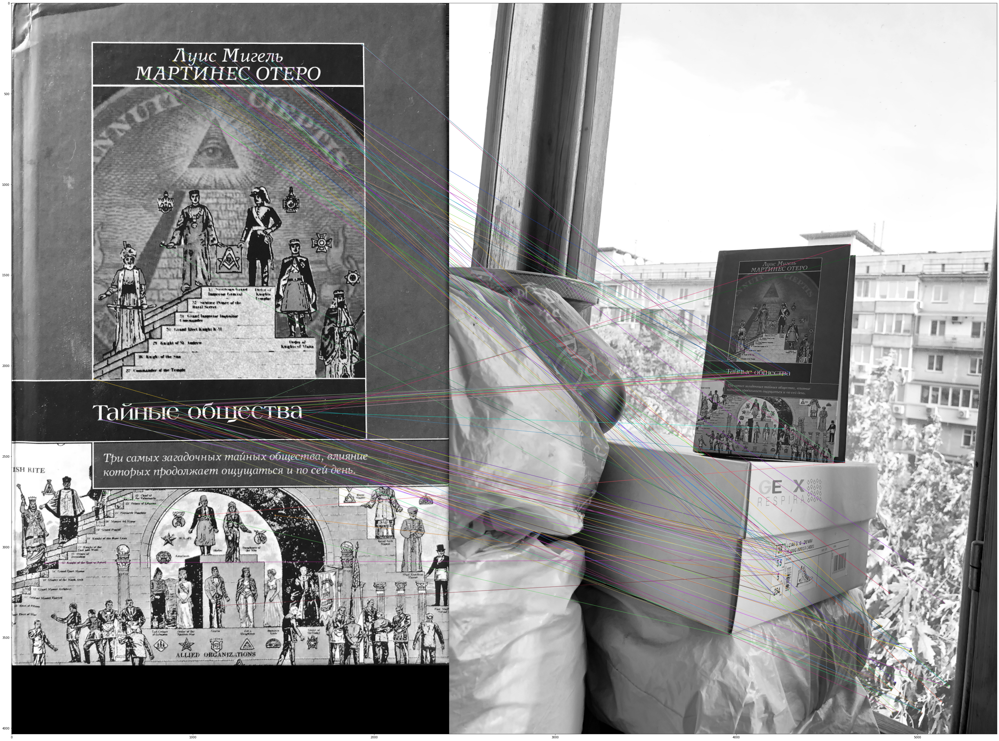

In [14]:
fig2, ax2 = plt.subplots(figsize=(60, 60))
ax2.imshow(examples_result_orb[0])

In [15]:
def brief_cmp(brief, kp_brief_perfect, des_brief_perfect, perfect, not_perfect):
    start = time.time()
    kp_star_notperfect = star.detect(not_perfect, None)
    kp_brief_notperfect, des_brief_notperfect = brief.compute(not_perfect, kp_star_notperfect)
    
    
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des_brief_perfect, des_brief_notperfect)
    matches = sorted(matches, key = lambda x:x.distance)
    
    good_matches = matches
    img_matches = np.empty((max(perfect.shape[0], not_perfect.shape[0]), perfect.shape[1]+not_perfect.shape[1], 3), dtype=np.uint8)
    cv2.drawMatches(perfect,kp_brief_perfect,not_perfect,kp_brief_notperfect,matches,img_matches,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    end = time.time()
    duration = end - start
    
    correct_hit_percent = len(good_matches)/len(kp_brief_notperfect)
  
    
    localization_error = 0
    for i in range(len(good_matches)):
        localization_error = localization_error + good_matches[i].distance/len(good_matches)
    return img_matches, duration, correct_hit_percent, localization_error

In [16]:
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()
star = cv2.xfeatures2d.StarDetector_create()
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()
kp_star_perfect = star.detect(perfect,None)
kp_brief_perfect, des_brief_perfect = brief.compute(perfect, kp_star_perfect)

In [17]:
img1111, d, c, l = brief_cmp(brief, kp_brief_perfect, des_brief_perfect, perfect, images[5])###### TEST FOR BRIEF, SHOULD COMPILE

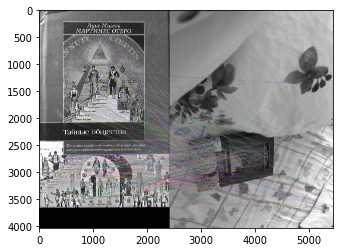

(<matplotlib.image.AxesImage at 0x7fb8ac9331f0>, None)

In [18]:
plt.imshow(img1111), plt.show() #### TEST IF ALL RIGHT, YOU SHOULD SEE PICTURE NORMALY

In [ ]:
######       CELL FOR RESULT OF BRIEF, TIME OF PROCEEDING ~5-7 MINUTES   #######
results_brief = []####ARRAY FOR PICTURES
duration_brief = []####### ARRAY FOR TIME
correct_hit_percents_brief = []#### ARRAY FOR 1ST METRIC
localization_errors_brief = []##### ARRAY FOR 2ND METRIC
size_brief = []#### ARRAY FOR SIZE OF PICTURE IN PIXELS(I GUESS)
for image in images:
    result, duration, correct_hit_percent, l_e = brief_cmp(brief, kp_brief_perfect, des_brief_perfect, perfect, image)
    results_brief.append(result)
    duration_brief.append(duration)
    correct_hit_percents_brief.append(correct_hit_percent)
    localization_errors_brief.append(l_e)
    size_brief.append((image.shape[1], image.shape[0]))

In [ ]:
# открываем новый файл на запись
workbook = xlsxwriter.Workbook('brief.xlsx')
# создаем там "лист"
worksheet = workbook.add_worksheet()
# в ячейку A1 пишем текст
worksheet.write('A1', 'localization_error')
worksheet.write('B1', 'correct_hit_percents')
worksheet.write('C1', 'duration')
worksheet.write('D1', 'size')
for i in range(len(localization_errors_brief)): ######### CHANGE ARRAY NAME LOCALIZATION_ERRORS_BRIEF -> YOUR ARRAY
        worksheet.write('A'+str(i+2), str(localization_errors_brief[i]))
        worksheet.write('B'+str(i+2), str(correct_hit_percents_brief[i]))
        worksheet.write('C'+str(i+2), str(duration_brief[i]))
        worksheet.write('D'+str(i+2), str(size_brief[i]))
# сохраняем и закрываем
workbook.close()